<a href="https://colab.research.google.com/github/mvvollmer/My-Projects/blob/main/SHAP_Plots_for_Field_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Install PyCaret**

In [ ]:
!pip install pycaret[full]

     |████████████████████████████████| 264 kB 5.5 MB/s 
     |████████████████████████████████| 271 kB 22.7 MB/s 
     |████████████████████████████████| 80 kB 5.6 MB/s 
     |████████████████████████████████| 167 kB 33.1 MB/s 
     |████████████████████████████████| 56 kB 2.9 MB/s 
     |████████████████████████████████| 2.0 MB 9.8 MB/s 
     |████████████████████████████████| 14.4 MB 60 kB/s 
     |████████████████████████████████| 6.8 MB 44.9 MB/s 
     |████████████████████████████████| 248 kB 63.7 MB/s 
     |████████████████████████████████| 1.7 MB 31.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 105 kB 47.7 MB/s 
     |████████████████████████████████| 1.3 MB 36.7 MB/s 
     |████████████████████████████████| 101 kB 10.0 MB/s 
     |████████████████████████████████| 166.7 MB 14 kB/s 
     |████████████████████

In [ ]:
from pycaret.utils import enable_colab 
enable_colab()

Colab mode enabled.


**Import Data**

In [ ]:
from google.colab import auth
auth.authenticate_user()

import gspread
from oauth2client.client import GoogleCredentials

gc = gspread.authorize(GoogleCredentials.get_application_default())

ws = gc.open_by_key('1SExzDFLacoNROmNeOdPVqVRYo9OliAtX2s3b1rDkgbk').sheet1
# get_all_values gives a list of rows.
rows = ws.get_all_values()

# Convert to a DataFrame and render.
import pandas as pd
df = pd.DataFrame.from_records(rows[1:],columns=rows[0])

**Setup Data**

In [ ]:
dataset = df
dataset = dataset.drop(["time", "tank", "anti_health","anti","geno","resist","plate","dataset"], axis=1)

In [ ]:
data = dataset.sample(frac=0.7, random_state=786)
data_unseen = dataset.drop(data.index)
data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)
print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (293, 6958)
Unseen Data For Predictions: (126, 6958)


In [ ]:
numericalDataset = dataset.drop(["ID", "year", "season", "site", "health", "yrSeason"], axis=1)
NFI = numericalDataset.columns
NF = NFI.tolist()

In [ ]:
from pycaret.classification import *
# feature_selection when set to True, a subset of features are selected using a combination of various permutation importance techniques
# feature_selection_threshold is the threshold for feature selection
exp_clf101 = setup(data = data, target = 'health', session_id=123, numeric_features=NF, feature_selection = True, feature_selection_threshold = 0.8)

,Description,Value
0,session_id,123
1,Target,health
2,Target Type,Binary
3,Label Encoded,"D: 0, N: 1"
4,Original Data,"(293, 6958)"
5,Missing Values,False
6,Numeric Features,6952
7,Categorical Features,5
8,Ordinal Features,False
9,High Cardinality Features,False


In [ ]:
exp_clf101

(False,
 'box-cox',
 False,
 {'USI',
  'X',
  'X_test',
  'X_train',
  '_all_metrics',
  '_all_models',
  '_all_models_internal',
  '_available_plots',
  '_gpu_n_jobs_param',
  '_internal_pipeline',
  '_ml_usecase',
  'create_model_container',
  'data_before_preprocess',
  'display_container',
  'exp_name_log',
  'experiment__',
  'fix_imbalance_method_param',
  'fix_imbalance_param',
  'fold_generator',
  'fold_groups_param',
  'fold_groups_param_full',
  'fold_param',
  'fold_shuffle_param',
  'gpu_param',
  'html_param',
  'imputation_classifier',
  'imputation_regressor',
  'iterative_imputation_iters_param',
  'log_plots_param',
  'logging_param',
  'master_model_container',
  'n_jobs_param',
  'prep_pipe',
  'pycaret_globals',
  'seed',
  'stratify_param',
  'target_param',
  'transform_target_method_param',
  'transform_target_param',
  'y',
  'y_test',
  'y_train'},
 [],
 152    1
 143    1
 31     1
 271    1
 41     1
       ..
 262    0
 255    1
 37     1
 34     1
 55     

**Find best model**

In [ ]:
best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
nb,Naive Bayes,0.9900,0.9923,0.9846,1.0000,0.9920,0.9787,0.9797,0.150
rf,Random Forest Classifier,0.9805,0.9978,0.9923,0.9800,0.9857,0.9546,0.9569,0.640
ada,Ada Boost Classifier,0.9757,0.9989,0.9846,0.9800,0.9817,0.9454,0.9481,0.739
lr,Logistic Regression,0.9710,0.9980,0.9852,0.9737,0.9785,0.9335,0.9377,0.797
catboost,CatBoost Classifier,0.9710,0.9978,0.9846,0.9742,0.9784,0.9334,0.9377,79.242
et,Extra Trees Classifier,0.9707,0.9967,0.9923,0.9652,0.9783,0.9333,0.9356,0.675
lightgbm,Light Gradient Boosting Machine,0.9657,1.0000,0.9692,0.9800,0.9726,0.9260,0.9316,0.545
xgboost,Extreme Gradient Boosting,0.9612,0.9969,0.9698,0.9742,0.9704,0.9131,0.9191,5.845
lda,Linear Discriminant Analysis,0.9610,0.9886,0.9923,0.9523,0.9714,0.9100,0.9145,0.501
gbc,Gradient Boosting Classifier,0.9460,0.9857,0.9621,0.9571,0.9581,0.8806,0.8858,2.550


**Tune Data**

In [ ]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,0.9524,1.0000,1.0000,0.9333,0.9655,0.8889,0.8944
3,0.9524,1.0000,1.0000,0.9333,0.9655,0.8889,0.8944
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,0.9500,1.0000,1.0000,0.9333,0.9655,0.8750,0.8819
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,0.9500,0.9780,0.9231,1.0000,0.9600,0.8936,0.8987
9,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


In [ ]:
tuned_rf = tune_model(rf, n_iter=100)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,0.9524,1.0000,1.0000,0.9333,0.9655,0.8889,0.8944
3,0.9524,1.0000,1.0000,0.9333,0.9655,0.8889,0.8944
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,0.9500,0.9890,0.9231,1.0000,0.9600,0.8936,0.8987
9,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


**Feature importance plot**

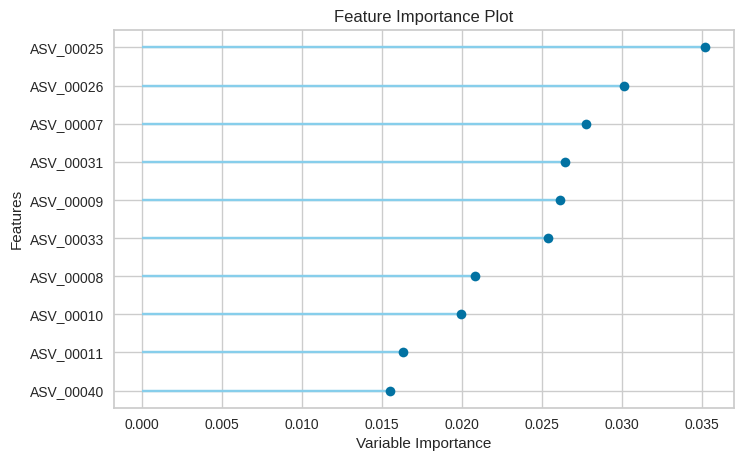

In [ ]:
plot_model(tuned_rf, 'feature')

**SHAP Plots**

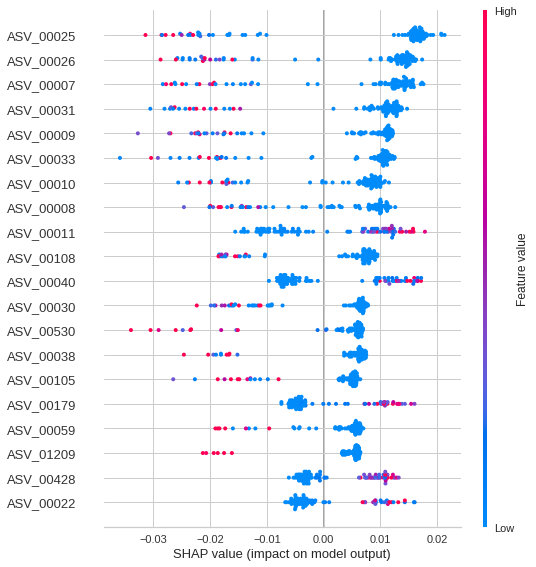

In [ ]:
interpret_model(tuned_rf)

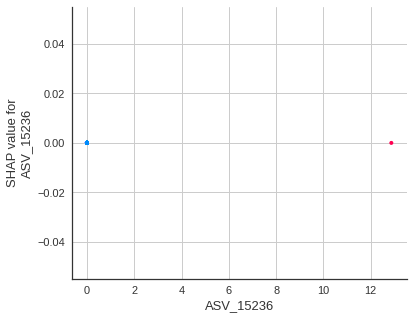

In [ ]:
interpret_model(tuned_rf, 'correlation')

In [ ]:
interpret_model(tuned_rf, 'reason')

In [ ]:
interpret_model(tuned_rf, 'pdp')

KeyboardInterrupt: ignored

In [ ]:
interpret_model(tuned_rf, 'msa')

KeyboardInterrupt: ignored

**SHAP summary plot**

In [ ]:
import shap

gg = df.iloc[1]
explainer = shap.TreeExplainer(tuned_rf)

shap_values = explainer.shap_values(numericalDataset)
shap_values

[array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]), array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]])]

In [ ]:
shap.

SyntaxError: ignored

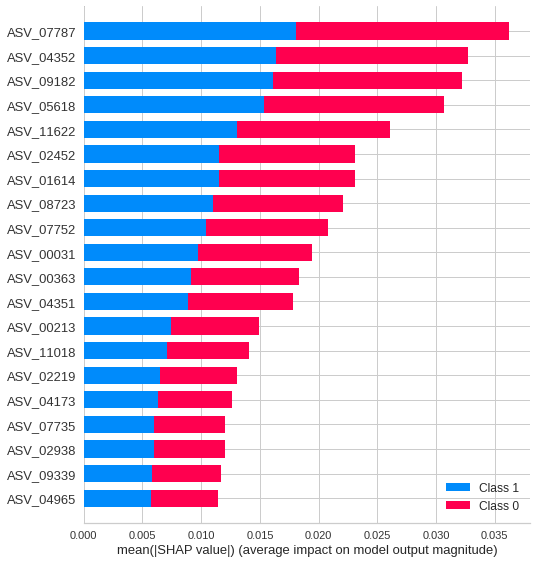

In [ ]:
shap.summary_plot(shap_values, numericalDataset, plot_type="bar")

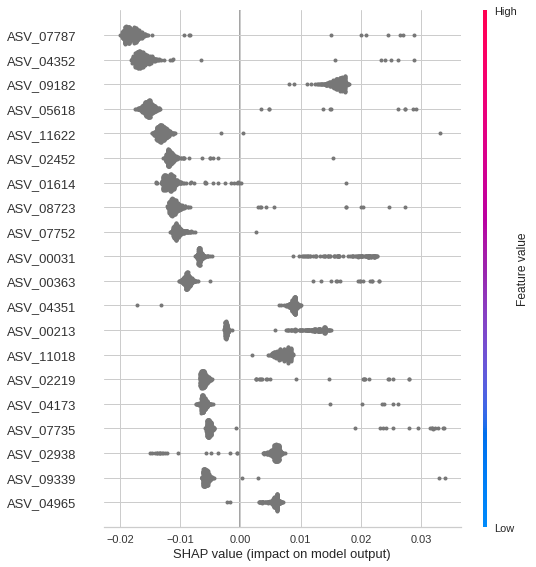

In [ ]:
shap.summary_plot(shap_values[0], numericalDataset, plot_type="dot")

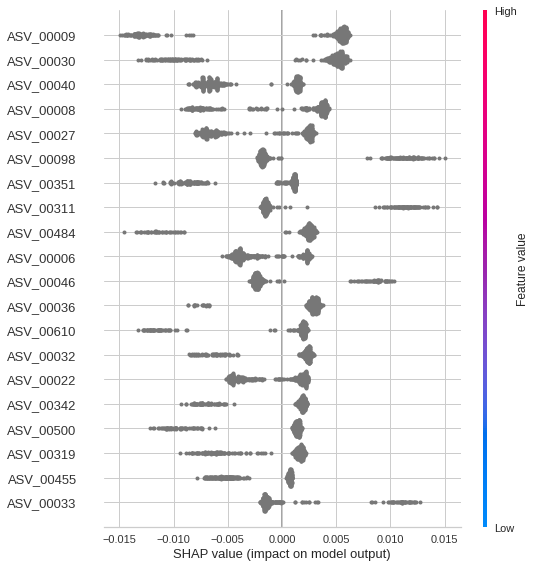

In [ ]:
shap.summary_plot(shap_values[1], numericalDataset, plot_type="dot")

In [ ]:
index = NF.index('ASV_00010')

7

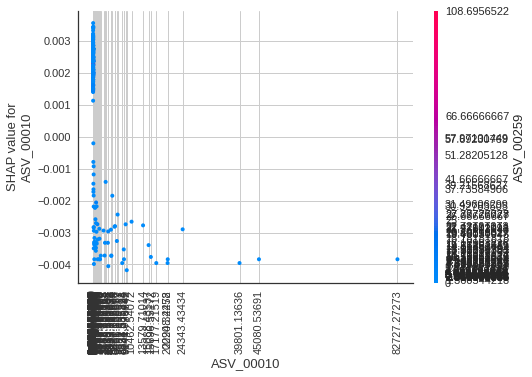

In [ ]:
shap.dependence_plot(index, shap_values[0], numericalDataset)